In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# text preprocessing
import re, string

### Data Acquisition

In [2]:
with open("../Datasets/imdb/imdb_trainX.txt", mode='r', encoding='utf-8', ) as f:
    Xtrain_raw = f.read()
    
with open("../Datasets/imdb/imdb_trainY.txt", mode='r', encoding='utf-8') as f:
    Ytrain_raw = f.read()

In [3]:
Xtrain_raw

'I loved this movie since I was 7 and I saw it on the opening day. It was so touching and beautiful. I strongly recommend seeing for all. It\'s a movie to watch with your family by far.<br /><br />My MPAA rating: PG-13 for thematic elements, prolonged scenes of disastor, nudity/sexuality and some language.\nFirst things first, Edison Chen did a fantastic, believable job as a Cambodian hit-man, born and bred in the dumps and a gladiatorial ring, where he honed his craft of savage battery in order to survive, living on the mantra of kill or be killed. In a role that had little dialogue, or at least a few lines in Cambodian/Thai, his performance is compelling, probably what should have been in the Jet Li vehicle Danny the Dog, where a man is bred for the sole purpose of fighting, and on someone else\'s leash.<br /><br />Like Danny the Dog, the much talked about bare knuckle fight sequences are not choreographed stylistically, but rather designed as normal, brutal fisticuffs, where everyth

In [4]:
Ytrain_raw

'10\n8\n7\n8\n8\n8\n10\n9\n10\n8\n8\n8\n10\n8\n8\n8\n9\n10\n7\n7\n8\n7\n8\n9\n8\n7\n10\n10\n7\n9\n9\n7\n10\n10\n10\n10\n7\n9\n10\n9\n10\n9\n10\n8\n8\n10\n8\n10\n8\n8\n8\n7\n8\n8\n7\n7\n10\n10\n7\n10\n7\n9\n10\n8\n7\n10\n10\n10\n7\n10\n10\n8\n8\n8\n10\n10\n10\n8\n10\n10\n9\n9\n8\n8\n9\n7\n9\n10\n10\n7\n7\n10\n10\n7\n7\n10\n8\n8\n10\n10\n10\n7\n10\n8\n10\n8\n8\n8\n9\n8\n10\n10\n9\n10\n7\n10\n10\n10\n8\n10\n10\n10\n10\n8\n8\n8\n8\n8\n10\n10\n10\n10\n8\n8\n8\n7\n10\n7\n10\n10\n8\n10\n9\n9\n10\n7\n9\n10\n8\n9\n8\n7\n8\n10\n7\n8\n10\n10\n10\n10\n10\n9\n9\n10\n8\n10\n10\n10\n10\n9\n8\n10\n10\n7\n9\n9\n7\n10\n10\n7\n10\n7\n8\n10\n7\n7\n10\n10\n10\n10\n8\n9\n8\n10\n10\n7\n10\n9\n10\n8\n9\n10\n10\n7\n8\n7\n7\n7\n10\n7\n10\n10\n10\n10\n10\n9\n10\n9\n8\n8\n10\n10\n9\n10\n10\n9\n10\n10\n10\n8\n10\n8\n10\n8\n8\n7\n7\n9\n7\n8\n9\n10\n9\n7\n7\n9\n8\n10\n10\n10\n10\n10\n8\n10\n10\n8\n10\n9\n8\n7\n9\n8\n10\n10\n7\n10\n10\n10\n10\n9\n7\n9\n8\n10\n8\n7\n10\n9\n10\n7\n8\n10\n10\n9\n10\n7\n7\n7\n10\n10\n9\n

### Text Preprocessing - Data Cleaning

In [5]:
Ytrain = [int(y) for y in Ytrain_raw.split('\n')]

In [6]:
print(len(Ytrain))
Ytrain[:10]

25000


[10, 8, 7, 8, 8, 8, 10, 9, 10, 8]

In [7]:
Xtrain = Xtrain_raw.lower().split('\n')

In [8]:
print(len(Xtrain))
Xtrain[:5]

25000


["i loved this movie since i was 7 and i saw it on the opening day. it was so touching and beautiful. i strongly recommend seeing for all. it's a movie to watch with your family by far.<br /><br />my mpaa rating: pg-13 for thematic elements, prolonged scenes of disastor, nudity/sexuality and some language.",
 "first things first, edison chen did a fantastic, believable job as a cambodian hit-man, born and bred in the dumps and a gladiatorial ring, where he honed his craft of savage battery in order to survive, living on the mantra of kill or be killed. in a role that had little dialogue, or at least a few lines in cambodian/thai, his performance is compelling, probably what should have been in the jet li vehicle danny the dog, where a man is bred for the sole purpose of fighting, and on someone else's leash.<br /><br />like danny the dog, the much talked about bare knuckle fight sequences are not choreographed stylistically, but rather designed as normal, brutal fisticuffs, where every

- The given documents have line breaks using `<br /><br />` tag
- There are backslash in words with single quote (') `e.g., it\'s` `there\'s`
- There are forwardslash between 2 words e.g., `nudity/sexuality`
- There are some documents with abbreviations like `"f"` are also present, which may decrease performance.
- There are some documents with double dash `--`
- There is `\x91` character present in some of the docs

replace `<br />` `<br />` with space

In [9]:
def tag_removal(text):
    tag_pattern = re.compile(r"<.*?><.*?>")
    return tag_pattern.sub(r' ', text)

In [10]:
Xtrain = [tag_removal(doc) for doc in Xtrain]

remove punctuation -> ``!"#$%&\'()*+,.:;<=>?@[\\]^_`{|}~``

In [11]:
def punc_removal(text: str):
    punc = string.punctuation.replace("-", "").replace("/", "") # remove dash and forward-slash from punctutation
    return text.translate(str.maketrans(' ', ' ', punc))

In [12]:
Xtrain = [punc_removal(doc) for doc in Xtrain]

replace single-dash (and, double-dash) `--` and forward-slash `/` space

In [13]:
Xtrain = [doc.replace("-", " ").replace("/", " ") for doc in Xtrain]

remove `\x91` character from docs

In [14]:
count = 0
for doc in Xtrain:
    output = re.findall(r"\x91", doc)
    if output != []:
        print(count, output)
    count += 1

4 ['\x91']
388 ['\x91', '\x91']
472 ['\x91']
1484 ['\x91', '\x91', '\x91', '\x91']
1903 ['\x91', '\x91', '\x91']
3690 ['\x91', '\x91', '\x91', '\x91']
4533 ['\x91', '\x91', '\x91']
4665 ['\x91', '\x91']
4935 ['\x91']
4945 ['\x91']
5252 ['\x91']
5740 ['\x91', '\x91', '\x91', '\x91', '\x91', '\x91', '\x91', '\x91', '\x91', '\x91', '\x91']
6022 ['\x91', '\x91', '\x91']
6354 ['\x91']
8177 ['\x91']
8283 ['\x91', '\x91']
8396 ['\x91', '\x91']
10409 ['\x91', '\x91', '\x91']
10743 ['\x91', '\x91', '\x91', '\x91', '\x91', '\x91', '\x91', '\x91']
12240 ['\x91']
14214 ['\x91']
16328 ['\x91']
17919 ['\x91', '\x91']
18017 ['\x91']
18151 ['\x91', '\x91']
22464 ['\x91']
22727 ['\x91', '\x91', '\x91', '\x91']
24580 ['\x91', '\x91', '\x91', '\x91']


In [15]:
Xtrain = [doc.replace('\x91', '') for doc in Xtrain]

In [16]:
Xtrain[388]

' arriving by boxcar in new york city the shrewd young woman with the baby face begins to methodically canoodle her way to the top floors of power in a great bank barbara stanwyck is fascinating as the amoral heroine of this influential pre code drama without a shred of decency or regret she coolly manipulates the removal or destruction of the men unlucky enough to find themselves in her way a wonderful actress stanwyck has full opportunity here to display her ample talents appearing quite late in the story george brent is a welcome addition as the one fellow possibly able to handle stanwyck his sophisticated style of acting makes a nice counterpoint to her icy demeanor douglas dumbrille donald cook  henry kolker portray a succession of her unfortunate victims john wayne appears for just a few scant seconds as an unsuccessful suitor for stanwycks affections this would be the only time these two performers appeared together on screen movie mavens should recognize nat pendleton as a spea

# Tokenization - NLP text preprocessing

In [17]:
from nltk.tokenize import word_tokenize, RegexpTokenizer
from nltk.corpus import stopwords

from nltk.stem.snowball import EnglishStemmer, SnowballStemmer, PorterStemmer
from nltk.stem.lancaster import LancasterStemmer

from nltk.stem import WordNetLemmatizer

from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

tokenization

In [18]:
Xtrain_token = [word_tokenize(doc) for doc in Xtrain]

In [19]:
sw_token = set(stopwords.words('english'))

manual method for stopword removal

In [20]:
o = []
count = 0
for x in Xtrain_token:
    o.append([])
    for token in x:
        if token not in sw_token:
            o[count].append(token)
            
    count += 1

stemming - convert similar word/token to root/stem. 

stem may not have meaning in language

In [21]:
ps = PorterStemmer()

In [22]:
Xtrain_token = []
count = 0
for x in o:
    Xtrain_token.append([])
    for token in x:
        Xtrain_token[count].append(ps.stem(token))
    count += 1

### Visualization & Insights

In [23]:
len_docs = [len(doc) for doc in Xtrain_token]

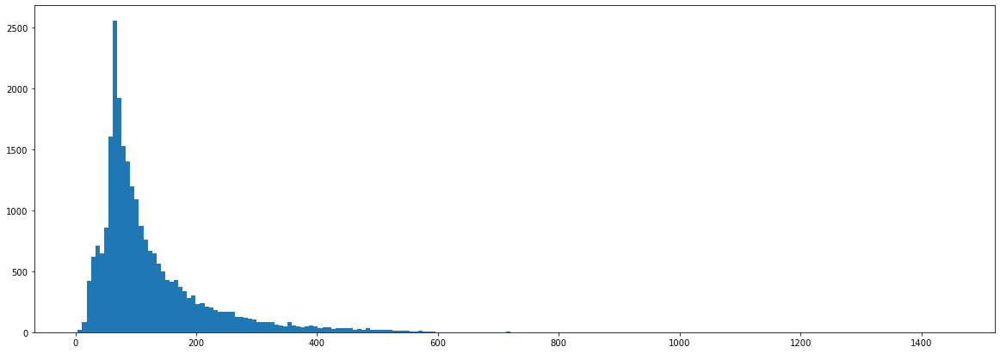

In [24]:
plt.figure(figsize=(20, 7))
plt.hist(len_docs, bins=200)
plt.show()

- The review with maximum relevant word is 1449
- The least relevant words is only 4
- From the histogram plot, we can infer that most reviews have #words between 20-180

In [25]:
print(max(len_docs))
print(min(len_docs))

1449
4


90% of the docs have #tokens between 17 to 262

In [26]:
mean = sum(len_docs)/len(len_docs)
print(mean)

123.3004


In [27]:
np.std(len_docs)

93.02749055972649

In [28]:
print(93*1.5-123, 123+93*1.5)

16.5 262.5


Relation b/w document word count and rating

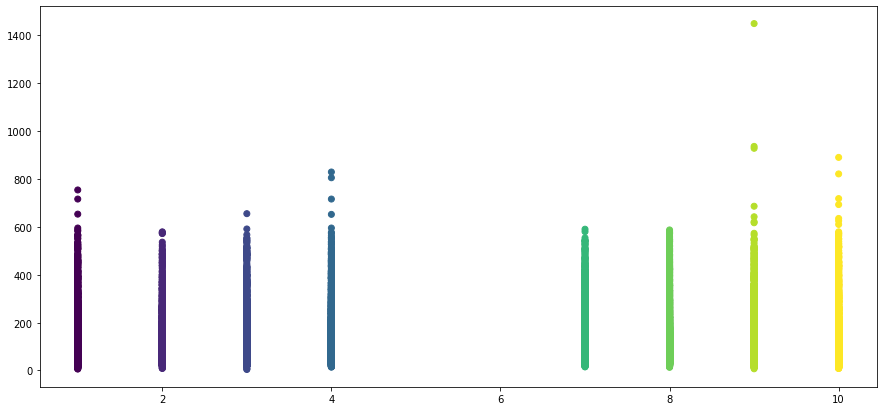

In [29]:
plt.figure(figsize=(15, 7))
plt.scatter(y=len_docs, x=Ytrain, c=Ytrain, )
plt.show()

From above plot and below computation, it is observed that there is no review with rating 5 and 6.
- This dataset has no 5 and 6 rating review and it's deviating from a real-world review as mostly or many people give avg. (5, 6) rating.

In [30]:
print(sum([y == 5 or y == 6 for y in Ytrain]))

0


vocabulary of the dataset: unique words in the corpus/dataset
- 65_486 unique token
- we can also use sklearn CountVectorizer function to find vocab and its size.

In [31]:
vocab = set()
for doc in Xtrain_token:
    vocab = set.union(vocab, set(doc))

In [32]:
len(vocab)

65486

- Through preprocessing, we have reduced vocab size from 92_761 to 65_486

In [33]:
cv = CountVectorizer()

In [34]:
cv.fit_transform(Xtrain)

<25000x92761 sparse matrix of type '<class 'numpy.int64'>'
	with 3461955 stored elements in Compressed Sparse Row format>

In [35]:
print(cv.vocabulary_)

{'loved': 49216, 'this': 82431, 'movie': 54883, 'since': 74847, 'was': 89147, 'and': 4278, 'saw': 71506, 'it': 42913, 'on': 58594, 'the': 82017, 'opening': 58833, 'day': 20734, 'so': 76006, 'touching': 83800, 'beautiful': 8191, 'strongly': 78871, 'recommend': 67268, 'seeing': 72678, 'for': 31568, 'all': 3517, 'its': 43040, 'to': 83265, 'watch': 89230, 'with': 90718, 'your': 92171, 'family': 29266, 'by': 12600, 'far': 29425, 'my': 55705, 'mpaa': 55127, 'rating': 66674, 'pg': 61920, '13': 170, 'thematic': 82071, 'elements': 26272, 'prolonged': 64823, 'scenes': 71771, 'of': 58204, 'disastor': 23128, 'nudity': 57638, 'sexuality': 73361, 'some': 76284, 'language': 46733, 'first': 30744, 'things': 82346, 'edison': 25842, 'chen': 15001, 'did': 22612, 'fantastic': 29386, 'believable': 8558, 'job': 43900, 'as': 5776, 'cambodian': 12962, 'hit': 38681, 'man': 50493, 'born': 10758, 'bred': 11301, 'in': 40979, 'dumps': 25244, 'gladiatorial': 34273, 'ring': 69306, 'where': 89996, 'he': 37453, 'honed

In [36]:
len(cv.vocabulary_)

92761

In [37]:
# verify vocab size of preprocessed corpus
temp = [' '.join(doc) for doc in Xtrain_token]
cv2 = CountVectorizer()
cv2.fit_transform(temp)
print(len(cv2.vocabulary_))

65126


token frequency in corpus

In [38]:
tfidf = TfidfVectorizer()
mat = tfidf.fit_transform(temp).toarray()

In [39]:
mat

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [40]:
print(len(tfidf.idf_))
print(tfidf.idf_)

65126
[ 8.48761377 10.43352392 10.43352392 ... 10.43352392  9.51723319
 10.43352392]


In [41]:
tfidf.get_feature_names_out()

array(['00', '000', '0000000000001', ..., 'østbye', 'über', 'üvegtigri'],
      dtype=object)

#### preprocessing analysis

In [42]:
' '.join(Xtrain).find('østbye')

2834877

In [43]:
' '.join(Xtrain)[2834877-100:2834877+10]

'nsemble play and im happy to say that ola b johannesen carries his mustache with nobility and marit østbye is '

In [44]:
Xtrain_raw.lower().find('johannesen carries his mustache')

2964497

In [45]:
Xtrain_raw[2964497: 2964497+100]

'Johannesen carries his mustache with nobility, and Marit Østbye is a really hot space chic of my sta'

In [46]:
' '.join(Xtrain).find('0000000000001')

25016571

In [47]:
' '.join(Xtrain)[25016571-100:25016571+50]

'it and get depressed my favorite part was when the credits started to roll i wish i could give it a 0000000000001 out of 10 i really wish i had that h'

In [48]:
Xtrain_raw.lower().find('0000000000001')

26195826

In [49]:
Xtrain_raw[26195826-100: 26195826+100]

"and get Depressed.\nMy Favorite part was when the credits started to roll. I wish I could give it a .0000000000001 out of 10. I really wish I had that Hour and thirty minutes back. Don't waste your mon"

### Feature Extraction | Text Representation | Text Vectorization

Bag of Words - unigram

In [50]:
bw = CountVectorizer()

In [51]:
bw_vector = bw.fit_transform(temp).toarray()

In [52]:
bw_vector

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=int64)

In [53]:
bw_vector.shape

(25000, 65126)

n-grams | bigram

In [55]:
bigram = CountVectorizer(ngram_range=(2,2))

In [56]:
bigram_vector = bigram.fit_transform(temp).toarray()

MemoryError: Unable to allocate 293. GiB for an array with shape (25000, 1573741) and data type int64

In [ ]:
bigram_vector.shape

In [ ]:
bigram

Tf-Idf | term frequency inverse document frequency

In [57]:
tfidf = TfidfVectorizer()

In [58]:
tfidf_vector = tfidf.fit_transform(temp).toarray()

MemoryError: Unable to allocate 12.1 GiB for an array with shape (25000, 65126) and data type float64

Word2Vec - The underlying assumption of word2vec is that two words sharing similar contexts <br>
           <tab> also share a similar meaning and consequently a similar vector representation from the model.
    
   e.g., - The football player took a shoot
           The hockey player took a shoot
    The above 2 statment are in similar context, so word2vec will create vector that shows football and hockey are sport and cricket is not.

In [61]:
import gensim

In [63]:
import gensim.downloader

In [66]:
gensim.downloader.

ValueError: unable to read local cache 'C:\\Users\\Monika/gensim-data\\information.json' during fallback, connect to the Internet and retry